In [1]:
import numpy as np
import PIL
import random
from PIL import Image
from PIL import ImageDraw
import pandas as pd

### Drawing Ellipses

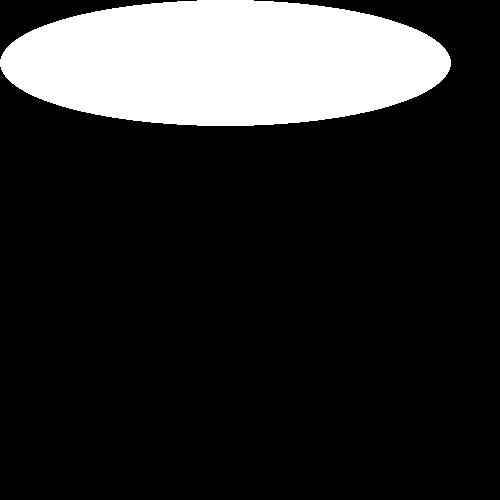

In [2]:
image = Image.new("RGB", (500,500))
draw = PIL.ImageDraw.Draw(image,None)
draw.ellipse([(0,0),(450,125)], fill=(255,255,255), outline=None, width=3)
image

### Drawing Arcs

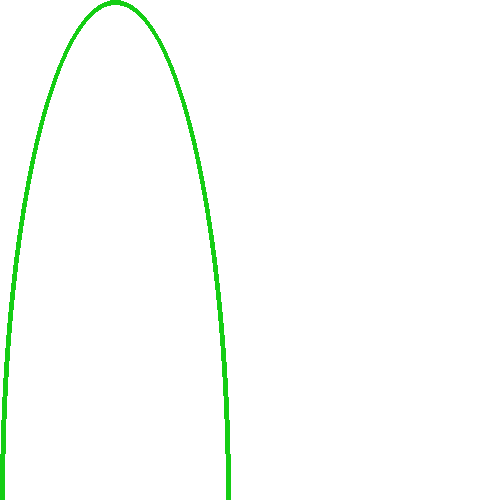

In [3]:
image = Image.new("RGBA", (500,500))
draw = PIL.ImageDraw.Draw(image,None)
draw.arc([(0,0),(230,1000)], 180, 360, fill=(20,205,20), width=5)
image

### Arc between two points with all of the same inputs as arc, plus added height

In [4]:
def two_point_arc(width, height, fill, line_width):
    image = Image.new("RGBA", (int(width),int(height)))
    draw = PIL.ImageDraw.Draw(image,None)
    draw.arc([(0,0),(int(width)-1,2*int(height))], 180, 360, fill, line_width)
    return image

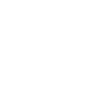

In [5]:
arc = two_point_arc(100,100,(255,255,255),5)
arc

### Now take two points on a larger image, create the arc, rotate it and insert it.

###### Practise

301.4962686336267
(301, 50)


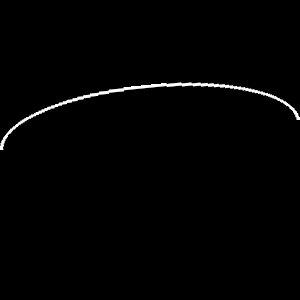

In [6]:
image = Image.new("RGBA", (300,300), (0,0,0))
draw = PIL.ImageDraw.Draw(image, None)
point_1 = (0,150)
point_2 = (300,120)
width = np.sqrt( (point_1[0] - point_2[0])**2 + (point_1[1] - point_2[1])**2)
print(width)
height = 50
arc = two_point_arc(int(width),height, (255,255,255), 3)
print(arc.size)
y_dist = np.abs(point_1[1]-point_2[1])
x_dist = np.abs(point_1[0]-point_2[0])
angle = np.arctan(y_dist/x_dist)*(180/np.pi)
arc = arc.rotate(angle, resample = PIL.Image.BICUBIC, expand = True)
#arc.size
paste_point = (point_1[0]-arc.size[0]+x_dist, point_1[1]-arc.size[1])
#box = ((2*point_1[0] +point_2[0] -x_size, point_1[1]-arc.size[1], 2*point_1[0] +point_2[0], point_1[1]))
image.paste(arc,paste_point, arc)
image

In [7]:
# Make an arc in an image, between the points pt_1 (x1,y1) and pt_2 (x2,y2)
# with given height, color, and line width
# Will place the arc "above" starting at pt_1 to pt_2
def upper_arc(image, pt_1, pt_2, height, color, line_width):
    
    if (pt_1[0] < pt_2[0]) and (pt_1[1] >= pt_2[1]):
        width = np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2)
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        y_dist = np.abs(pt_1[1]-pt_2[1])
        x_dist = np.abs(pt_1[0]-pt_2[0])
        angle = np.arctan(y_dist/x_dist)*(180/np.pi)
        arc = arc.rotate(angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = (pt_1[0]-arc.size[0]+x_dist, pt_1[1]-arc.size[1])
        image.paste(arc,paste_point, arc)
        
    if (pt_1[0] < pt_2[0]) and (pt_1[1] < pt_2[1]):
        width = np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2)
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        y_dist = np.abs(pt_1[1]-pt_2[1])
        x_dist = np.abs(pt_1[0]-pt_2[0])
        angle = np.arctan(y_dist/x_dist)*(180/np.pi)
        arc = arc.rotate(-angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = (pt_1[0], pt_1[1]+y_dist-arc.size[1])
        image.paste(arc, paste_point, arc)
        
    if (pt_1[0] > pt_2[0]) and (pt_1[1] <= pt_2[1]):
        width = np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2)
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        y_dist = np.abs(pt_1[1]-pt_2[1])
        x_dist = np.abs(pt_1[0]-pt_2[0])
        angle = np.arctan(y_dist/x_dist)*(180/np.pi)
        arc = arc.rotate(180+angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = (pt_1[0]- x_dist, pt_1[1])
        image.paste(arc, paste_point, arc)
        
    if (pt_1[0] > pt_2[0]) and (pt_1[1] > pt_2[1]):
        width = np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2)
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        y_dist = np.abs(pt_1[1]-pt_2[1])
        x_dist = np.abs(pt_1[0]-pt_2[0])
        angle = np.arctan(y_dist/x_dist)*(180/np.pi)
        arc = arc.rotate(180-angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = (pt_1[0]- arc.size[0], pt_1[1]-y_dist)
        image.paste(arc, paste_point, arc)
        
    if (pt_1[0] == pt_2[0]) and (pt_1[1] < pt_2[1]):
        width = pt_2[1] - pt_1[1]
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        angle = -90
        arc = arc.rotate(angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = pt_1
        image.paste(arc, paste_point, arc)
        
    if (pt_1[0] == pt_2[0]) and (pt_1[1] > pt_2[1]):
        width = pt_1[1] - pt_2[1]
        height = int(height)
        arc = two_point_arc(int(width), height, color, line_width)
        angle = 90
        arc = arc.rotate(angle, resample = PIL.Image.BICUBIC, expand = True)
        paste_point = (pt_1[0]-arc.size[0], pt_2[1])
        image.paste(arc, paste_point, arc)
        
    return image

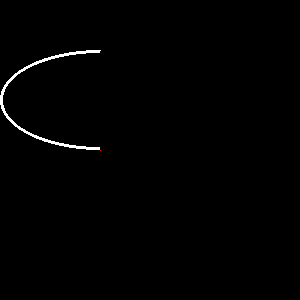

In [8]:
image = Image.new("RGBA", (300,300), (0,0,0))
upper_arc(image, (100,150), (100,50), 100, (255,255,255), 3)
draw = PIL.ImageDraw.Draw(image)
draw.point((100,150), (255,0,0))
draw.point((100,50), (255,255,255))
image

### Now to make a picture where I pick points on a circle and draw arcs

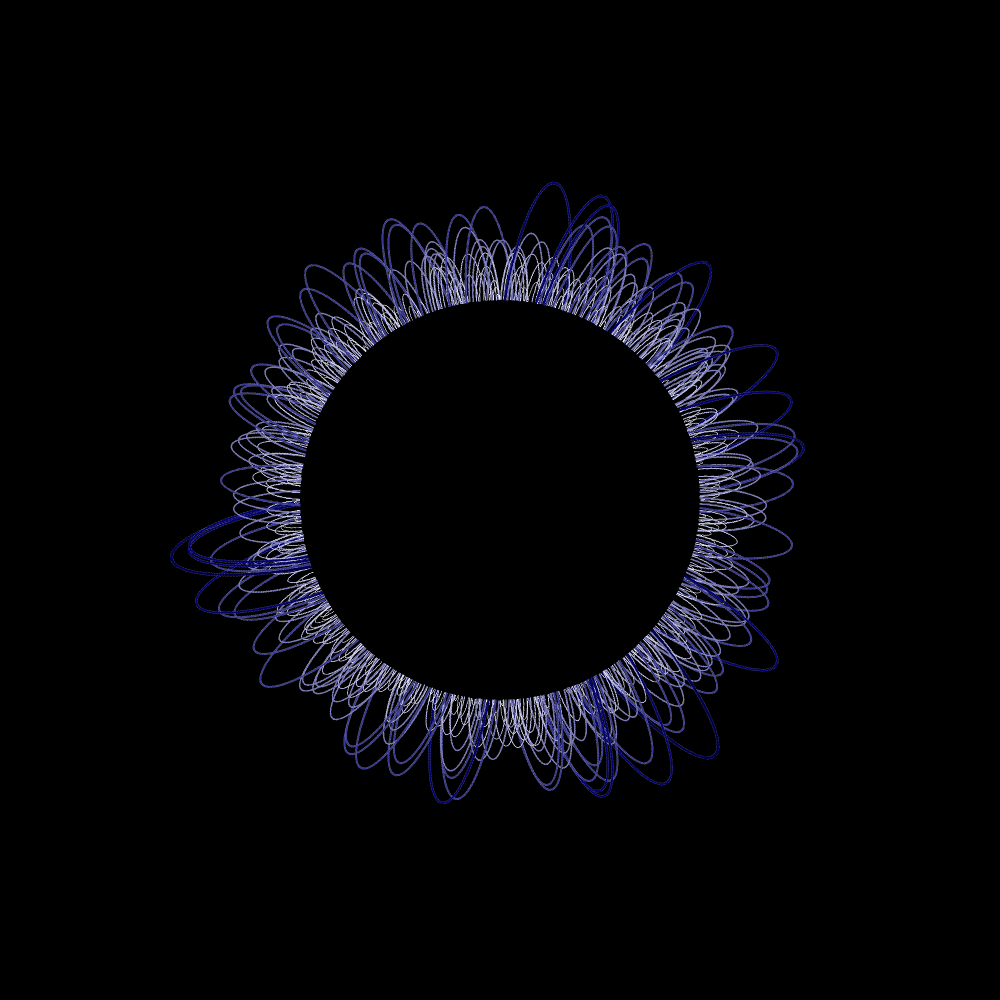

In [9]:
image = Image.new("RGBA", (2000,2000), (0,0,0))
center = (int(image.size[0]/2), int(image.size[1]/2))
radius = 400
circle_sub = 36
for n in range(circle_sub):
    coordinates = []
    base_angle = n*(360/circle_sub)
    angle_list = []
    max_D = 2*radius*np.sin((np.pi/180)*(720/circle_sub))
    for i in range(30):
        angle = random.randint(0,720/circle_sub)
        angle_list.append(angle)
    #print(angle_list)   
    angle_list.sort()
    #print(angle_list)
    for angle in angle_list:
        delta_x = int(radius * np.cos( (np.pi/180)*(angle+ base_angle) ) )
        delta_y = int(radius * np.sin( (np.pi/180)*(angle+ base_angle) ) )
        point = (center[0] - delta_x, center[1] - delta_y)
        coordinates.append(point)
        #print(angle, delta_x, delta_y, point)
    #Remove duplicates from list while maintaining order
    no_copies_coordinates = []
    [no_copies_coordinates.append(x) for x in coordinates if x not in no_copies_coordinates]
    #print(coordinates)
    
    for pt_1 in no_copies_coordinates[:-1]:
        #print(pt_1)
        pt_2 = random.choice( no_copies_coordinates[no_copies_coordinates.index(pt_1)+1:] )
        #print(pt_2)
        if (pt_2[0] == pt_1[0]):
            #pt_2 = random.choice(no_copies_coordinates)
            continue
            
        height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))*2
        line_width = ((int((height/max_D)*5))+1)
        color = (255-((line_width)*50),255-((line_width)*50),255-((line_width)*30))
        upper_arc(image, pt_1, pt_2, height, color, line_width)
image

In [18]:
image.save("Blue_hole_sun_1.png")

### Spiral Arcs

In [72]:
image = Image.new("RGBA", (2000,2000), (0,0,0))
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (255,255,255)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2

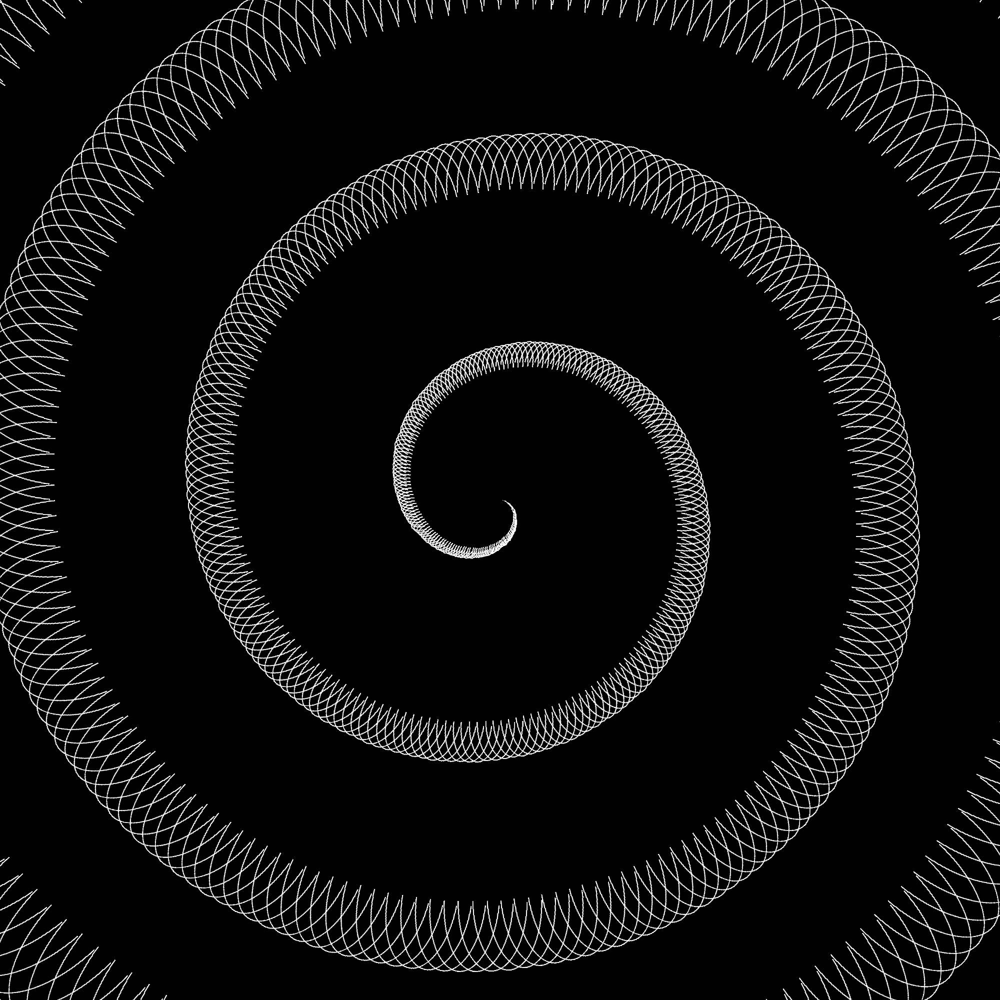

In [73]:
image

In [74]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 5
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (200,255,200)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2

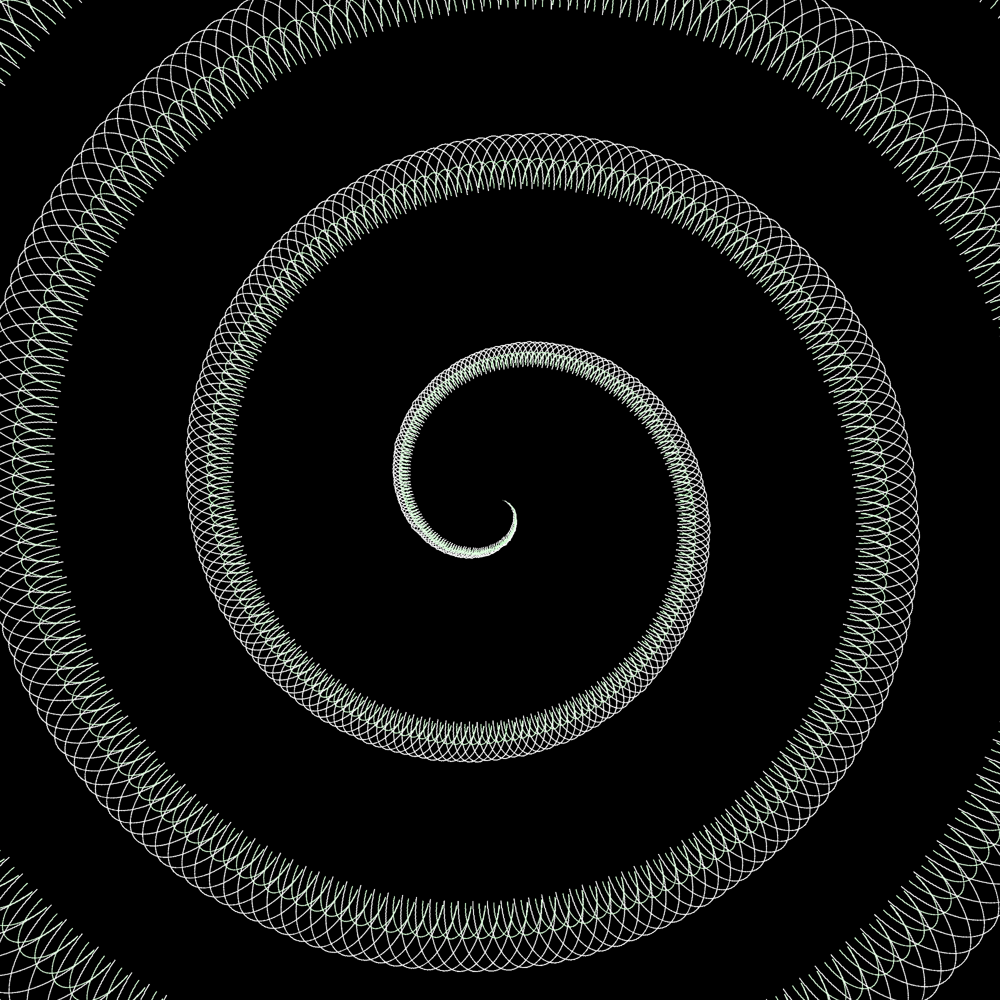

In [75]:
image

In [76]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 2
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (150,255,150)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2


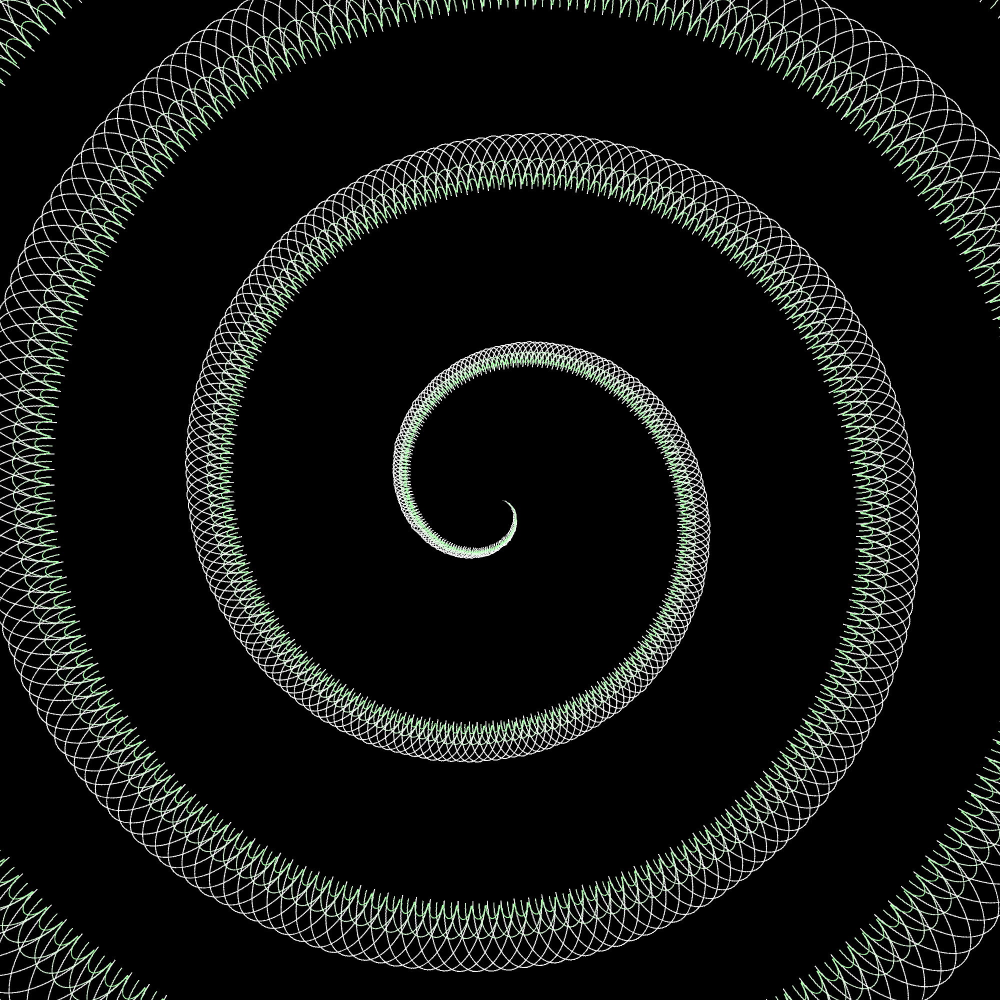

In [77]:
image

In [78]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 1
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (50,255,50)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2


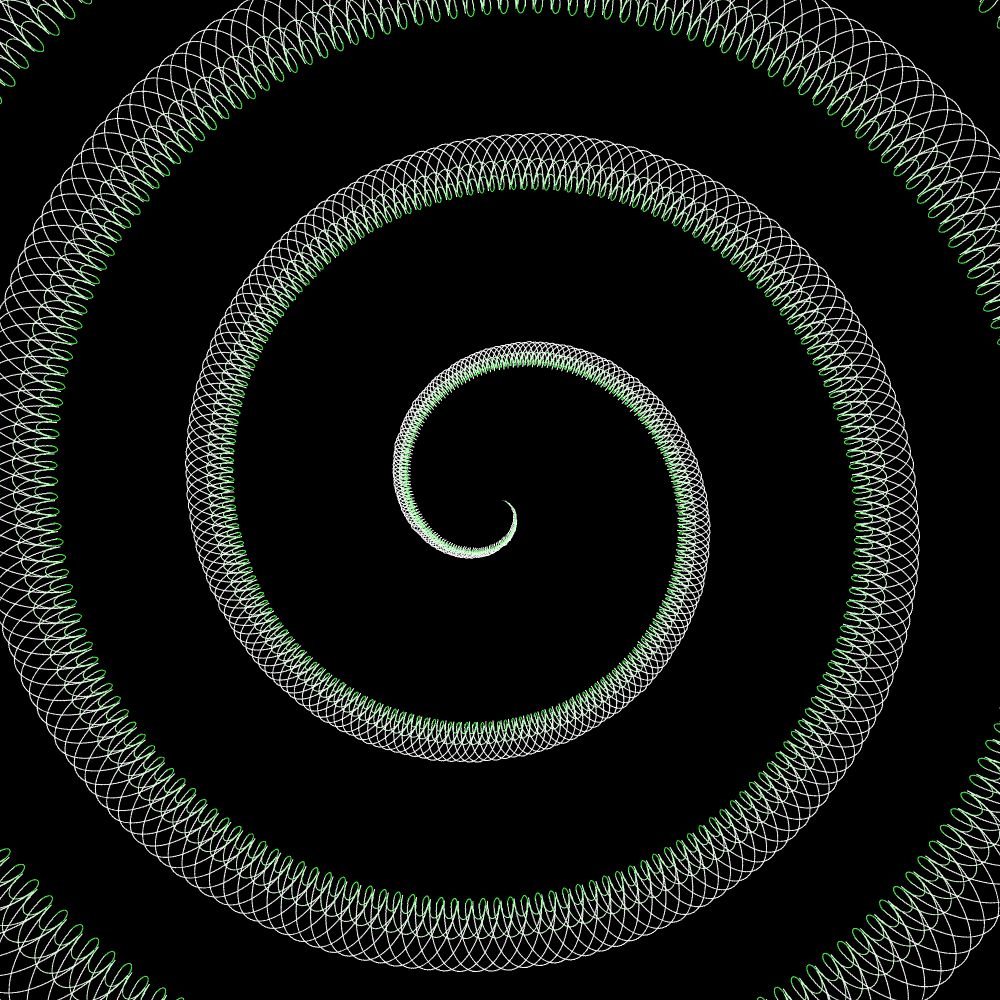

In [79]:
image

In [80]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 20
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (50,255,50)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2


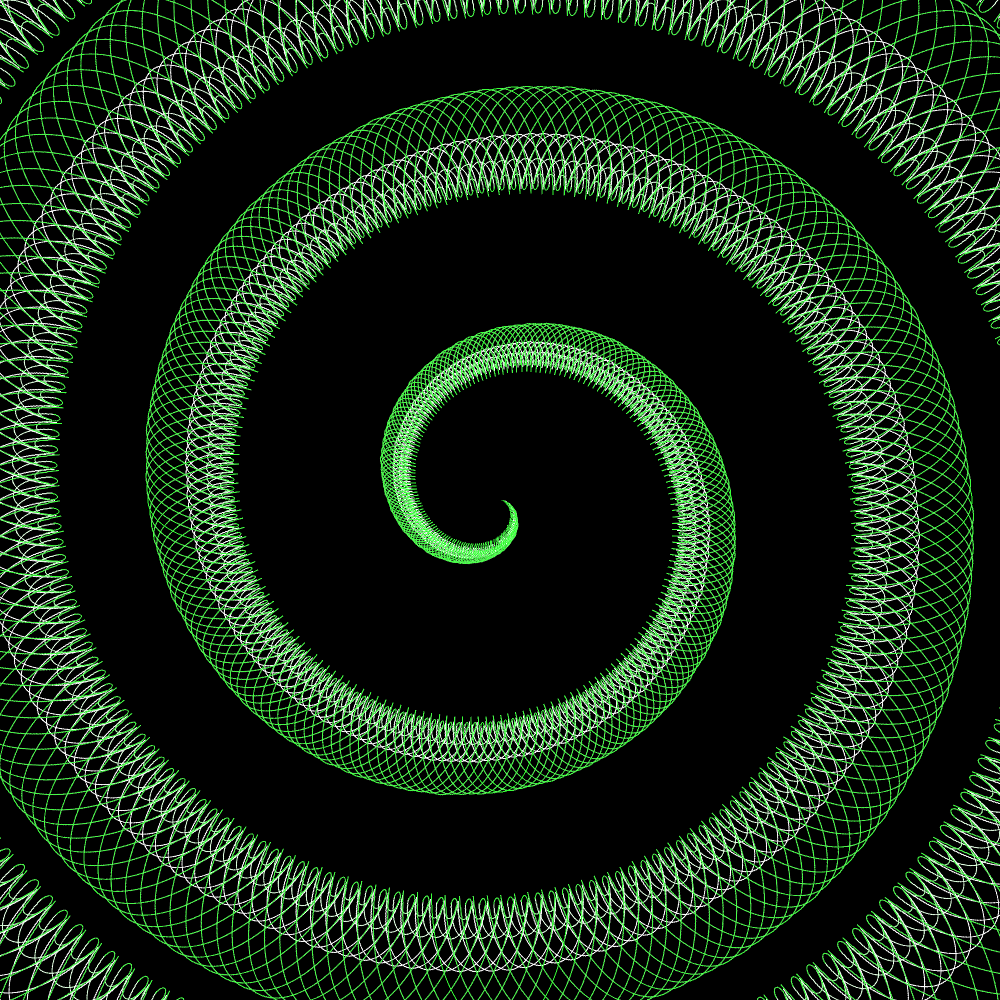

In [81]:
image

In [29]:
image.save("green_spiral_1.png")

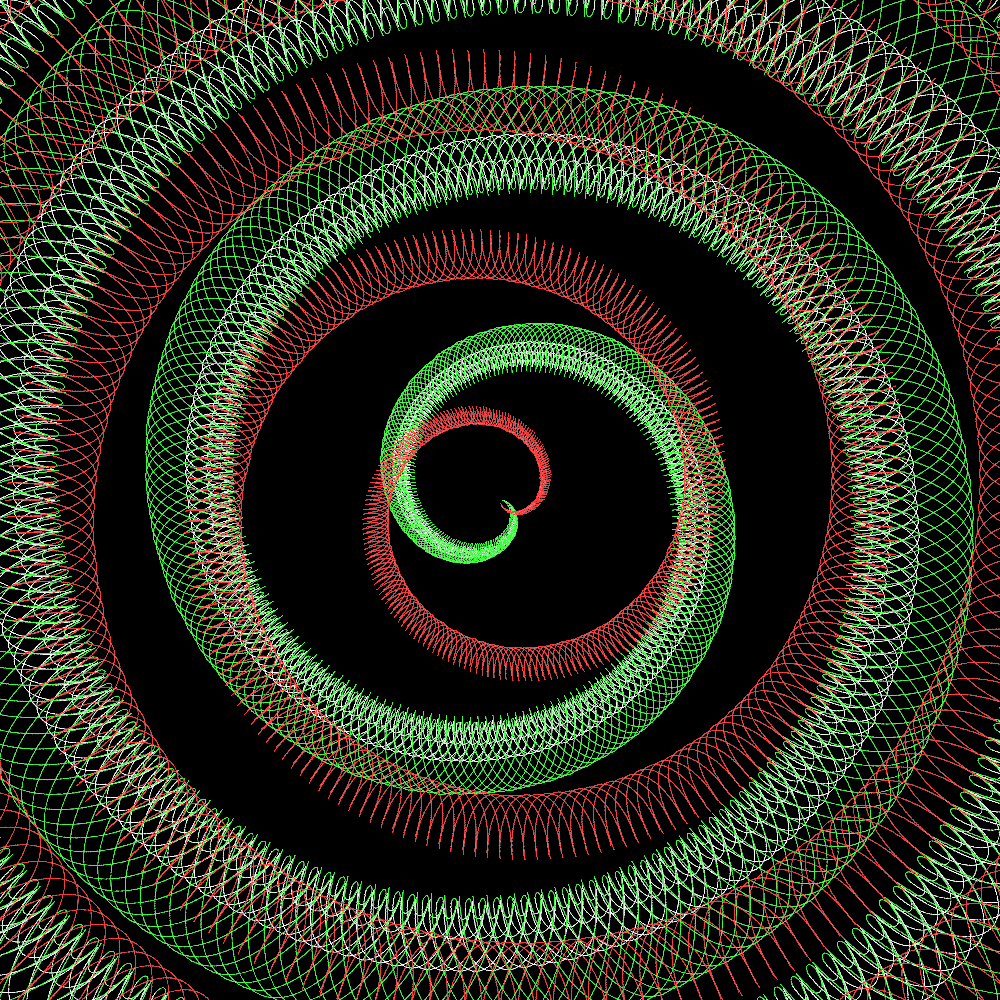

In [82]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.sin(theta*(np.pi/180)))
    delta_y = int(radius * np.cos(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.sin(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.cos(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (255,50,50)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2
image

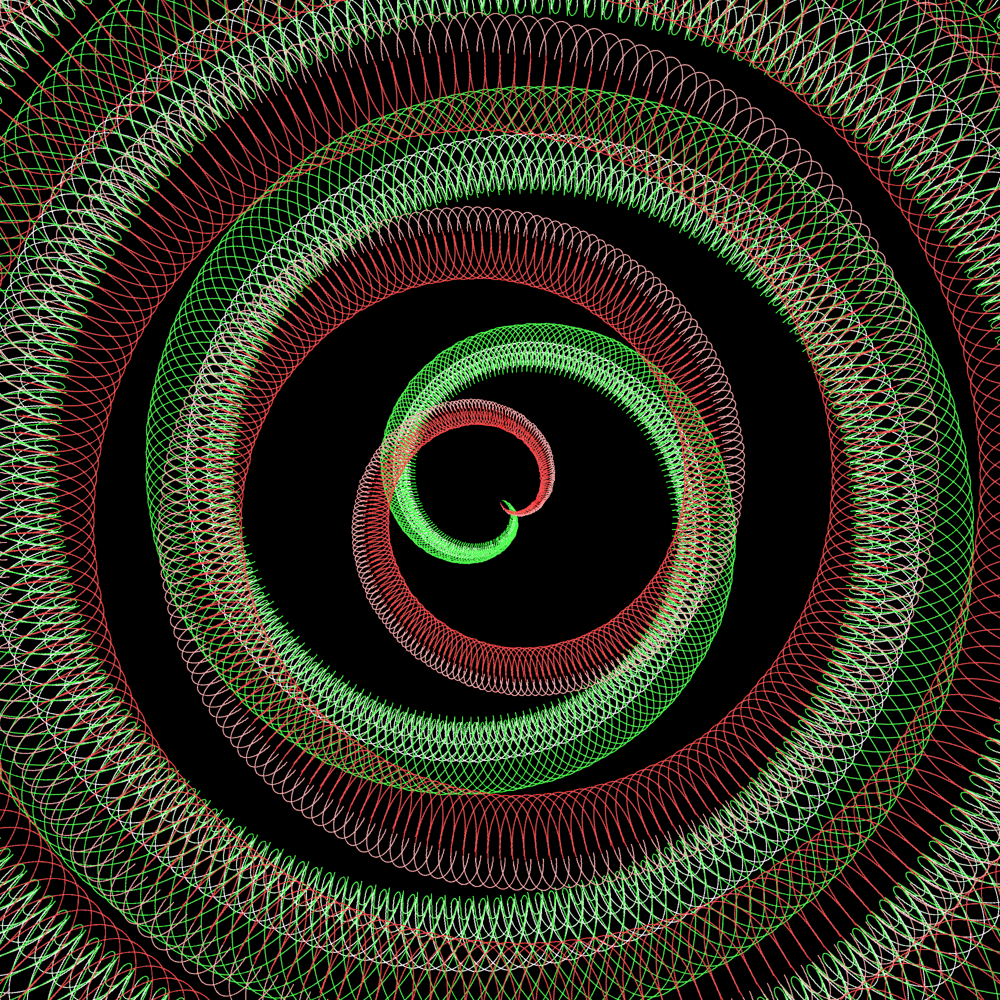

In [83]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.sin(theta*(np.pi/180)))
    delta_y = int(radius * np.cos(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 5
    radius_upper = theta_upper
    delta_x = int(radius * np.sin(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.cos(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (255,150,150)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2
image

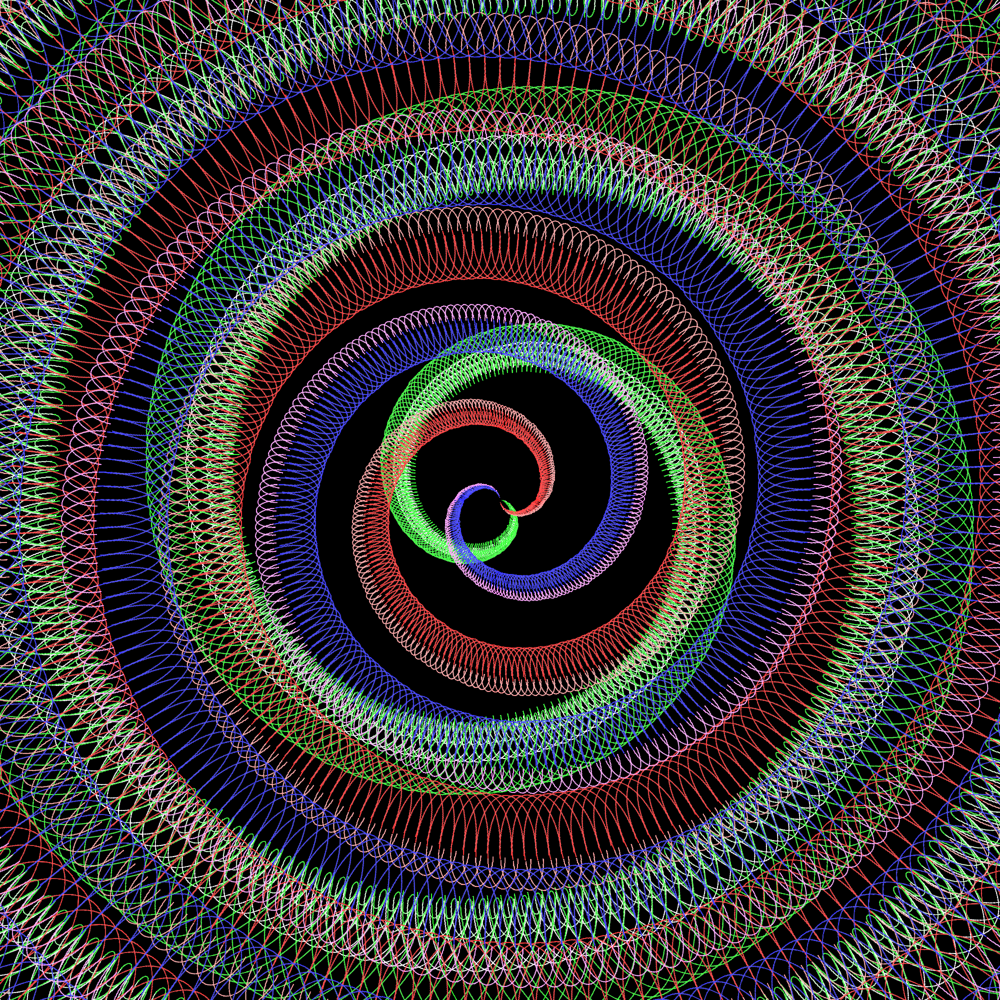

In [84]:
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = -int(radius * np.sin(theta*(np.pi/180)))
    delta_y = -int(radius * np.cos(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = -int(radius * np.sin(theta_upper*(np.pi/180)))
    delta_y = -int(radius * np.cos(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (50,50,255)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2
    
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = -int(radius * np.sin(theta*(np.pi/180)))
    delta_y = -int(radius * np.cos(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 5
    radius_upper = theta_upper
    delta_x = -int(radius * np.sin(theta_upper*(np.pi/180)))
    delta_y = -int(radius * np.cos(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (1505,150,255)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2
    
image

In [85]:
image.save("slinky_rainbow.png")

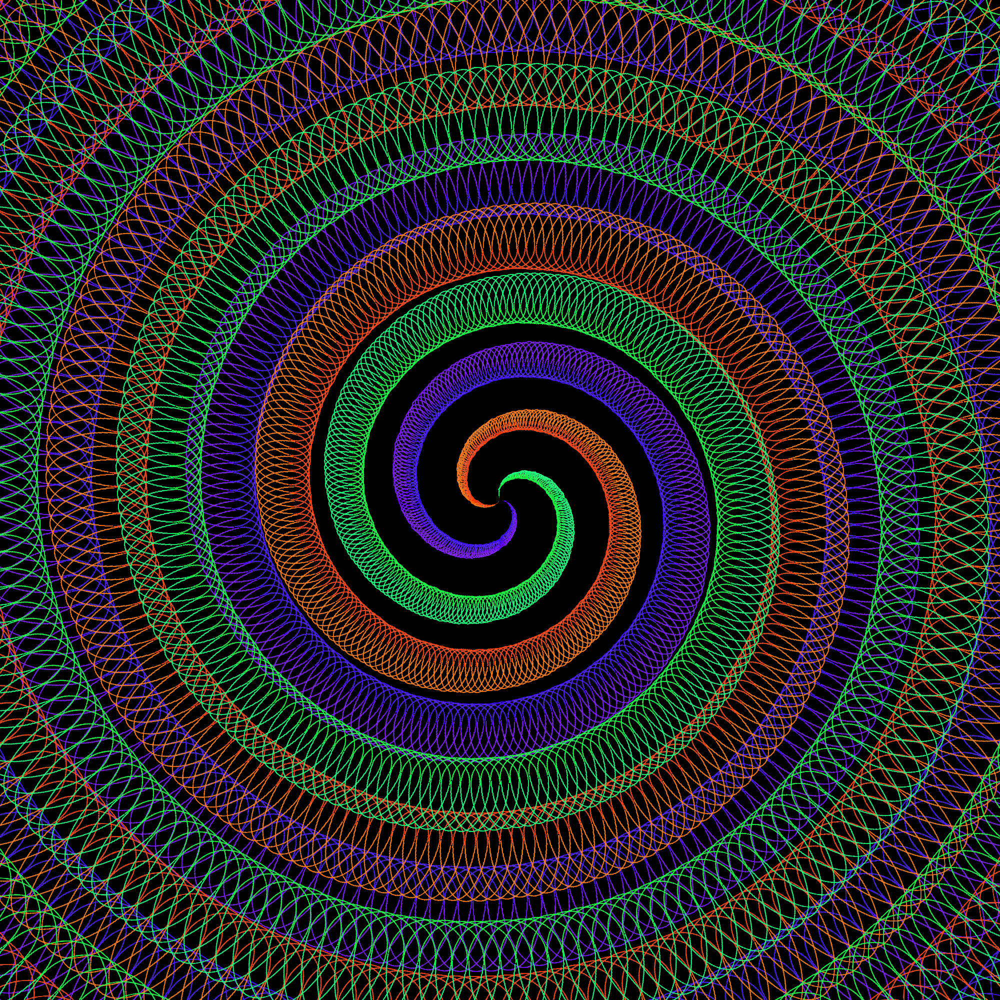

In [17]:
image = Image.new("RGBA", (2000,2000), (0,0,0))
center = (int(image.size[0]/2), int(image.size[1]/2))
theta_max = 2000
theta = 0
##Creating a purple and blue sprial
#Create a Purple spiral
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (100,0,255)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2
#Create a bluer spiral connected but shorter
theta = 0
while theta < theta_max:
    radius = theta
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))/2
    color = (50,0,255)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2
##Create an orange and red spiral
theta = 120
while theta < theta_max:
    radius = theta-120
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (255,100,0)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2

theta = 120
while theta < theta_max:
    radius = theta-120
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))/2
    color = (255,50,0)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2
    
theta = 240
while theta < theta_max:
    radius = theta-240
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))
    color = (0,255,100)
    line_width = 2
    
    upper_arc(image, pt_1, pt_2, int(height), color, line_width)
    theta = theta + 2

theta = 240
while theta < theta_max:
    radius = theta-240
    delta_x = int(radius * np.cos(theta*(np.pi/180)))
    delta_y = int(radius * np.sin(theta*(np.pi/180)))
    pt_1 = (center[0]+delta_x, center[1]+delta_y)
    
    theta_upper = theta + 10
    radius_upper = theta_upper
    delta_x = int(radius * np.cos(theta_upper*(np.pi/180)))
    delta_y = int(radius * np.sin(theta_upper*(np.pi/180)))
    pt_2 = (center[0]+delta_x, center[1]+delta_y)
    
    height = (np.sqrt( (pt_1[0] - pt_2[0])**2 + (pt_1[1] - pt_2[1])**2))/2
    color = (0,255,50)
    line_width = 2
    
    upper_arc(image, pt_2, pt_1, int(height), color, line_width)
    theta = theta + 2
image

In [18]:
image.save("Slinky_Rainbow_2.png")